# Breast Cancer Winconsin (Diagnostic) 

## Comprehensive EDA with all Feature Analysis

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
import plotly.figure_factory as ff
from plotly import tools
from plotly.subplots import make_subplots
from plotly.offline import iplot

from autoviz.AutoViz_Class import AutoViz_Class

from sklearn.datasets import load_breast_cancer

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

Imported AutoViz_Class version: 0.0.85. Call using:
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not show plot but creates them and saves them in AutoViz_Plots directory in your local machine.


In [2]:
ds = load_breast_cancer()
ds['feature_names']

array(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error',
       'fractal dimension error', 'worst radius', 'worst texture',
       'worst perimeter', 'worst area', 'worst smoothness',
       'worst compactness', 'worst concavity', 'worst concave points',
       'worst symmetry', 'worst fractal dimension'], dtype='<U23')

In [3]:
data = pd.DataFrame(ds['data'], columns=ds['feature_names'])
target = pd.DataFrame(ds['target'], columns=['class'])
data.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [4]:
# replace encoded labels with actual labels
labels_dict = {0:"Malignant", 1:"Benign"}
target.replace(labels_dict, inplace=True)
target.tail()

,class
564,Malignant
565,Malignant
566,Malignant
567,Malignant
568,Benign


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [6]:
data.describe(include='all')

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [7]:
data.isnull().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
dtype: int64

In [8]:
data.skew()

mean radius                0.942380
mean texture               0.650450
mean perimeter             0.990650
mean area                  1.645732
mean smoothness            0.456324
mean compactness           1.190123
mean concavity             1.401180
mean concave points        1.171180
mean symmetry              0.725609
mean fractal dimension     1.304489
radius error               3.088612
texture error              1.646444
perimeter error            3.443615
area error                 5.447186
smoothness error           2.314450
compactness error          1.902221
concavity error            5.110463
concave points error       1.444678
symmetry error             2.195133
fractal dimension error    3.923969
worst radius               1.103115
worst texture              0.498321
worst perimeter            1.128164
worst area                 1.859373
worst smoothness           0.415426
worst compactness          1.473555
worst concavity            1.150237
worst concave points       0

In [9]:
data.corr()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
mean radius,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
mean texture,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
mean perimeter,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
mean area,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
mean smoothness,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
mean compactness,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
mean concavity,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
mean concave points,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
mean symmetry,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,0.479921,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413
mean fractal dimension,-0.311631,-0.076437,-0.261477,-0.283110,0.584792,0.565369,0.336783,0.166917,0.479921,1.000000,...,-0.253691,-0.051269,-0.205151,-0.231854,0.504942,0.458798,0.346234,0.175325,0.334019,0.767297


### Correlation Heat Map 

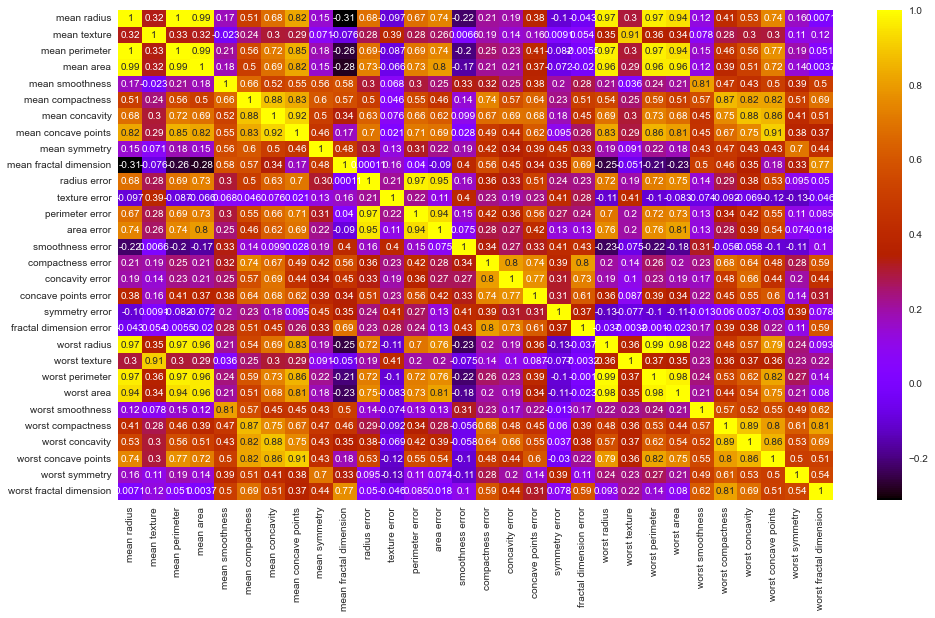

In [10]:
plt.figure(figsize=(16,9))
ax = sns.heatmap(data.corr(),annot = True,cmap = 'gnuplot')
plt.show()

### Shifted Heat Map

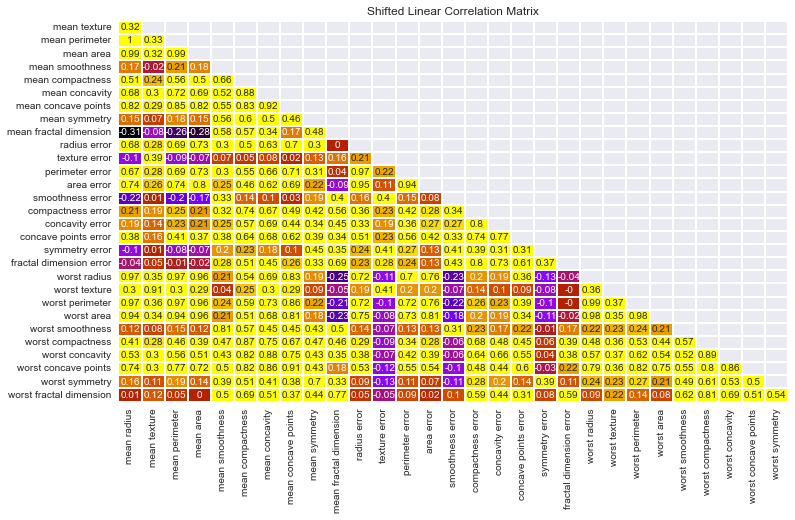

In [11]:
''' Plot a Shifted Correlation Matrix '''
# Diagonal correlation is always unity & less relevant, shifted variant shows only relevant cases

def corrMat(df,id=False):
    
    corr_mat = df.corr().round(2)
    f, ax = plt.subplots(figsize=(12,7))
    mask = np.triu(np.ones_like(corr_mat, dtype=bool))
    mask = mask[1:,:-1]
    corr = corr_mat.iloc[1:,:-1].copy()
    sns.heatmap(corr,mask=mask,vmin=-0.3,vmax=0.3,center=0, 
                cmap='gnuplot',square=False,lw=2,annot=True,cbar=False)
#     bottom, top = ax.get_ylim() 
#     ax.set_ylim(bottom + 0.5, top - 0.5) 
    ax.set_title('Shifted Linear Correlation Matrix')
    
corrMat(data)

### Data Distribution Plot

In [12]:
fig = make_subplots(rows=1,cols=2,
                    subplot_titles=('Countplot',
                                    'Percentages'),
                    specs=[[{"type": "xy"},
                            {'type':'domain'}]])

fig.add_trace(go.Bar(y = target.value_counts().values.tolist(), 
                     x = data.value_counts().index, 
                     text=target.value_counts().values.tolist(),
                     textfont=dict(size=15),
                     textposition = 'outside',
                     showlegend=False,
                     marker = dict(color = 'cyan',
                                   line_color = 'black',
                                   line_width=3)),row = 1,col = 1)

fig.add_trace((go.Pie(labels=target.value_counts().keys(),
                      values=target.value_counts().values,
                      textfont = dict(size = 16),
                      textposition='auto',
                      showlegend = True)), 
              row = 1, col = 2)

fig.update_layout(title={'text': 'Diagnosis Tissue State',
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  template='plotly_white')

fig.update_yaxes(range=[0,500])
iplot(fig)

In [13]:
df = pd.concat([data, target], axis=1)
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,class
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,Malignant
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,Malignant
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,Malignant
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,Malignant
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,Malignant


Shape of your Data Set loaded: (569, 31)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  30
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    30 Predictors classified...
        This does not include the Target column(s)
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification VISUALIZATION Started #####################
Data Set Shape: 569 rows, 31 cols
Too many columns to print
   Columns to delete:
'   []'
   Boolean variables %s 
'   []'
   Categorical variab

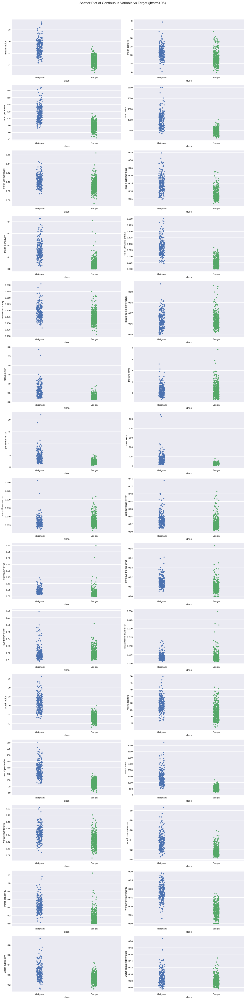

Total Number of Scatter Plots = 465


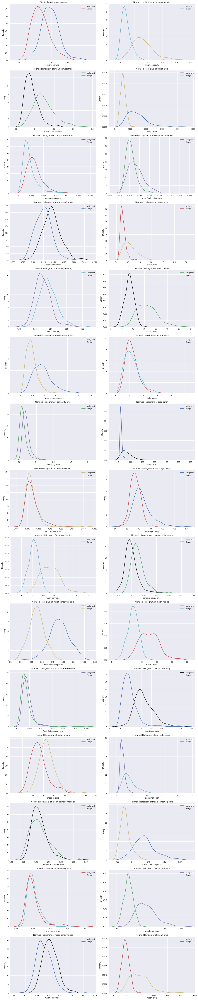

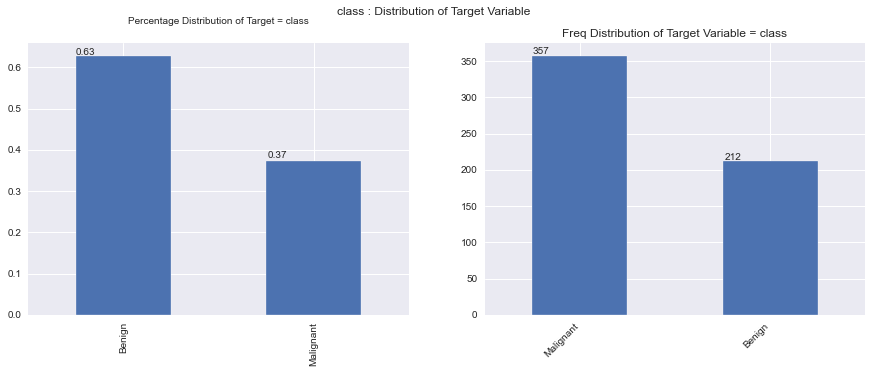

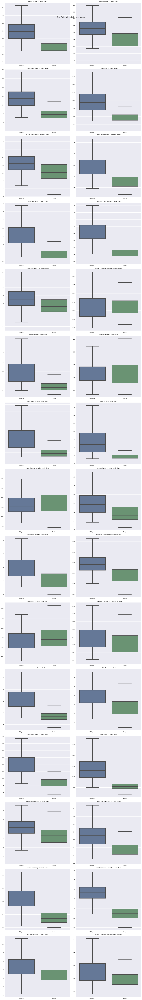

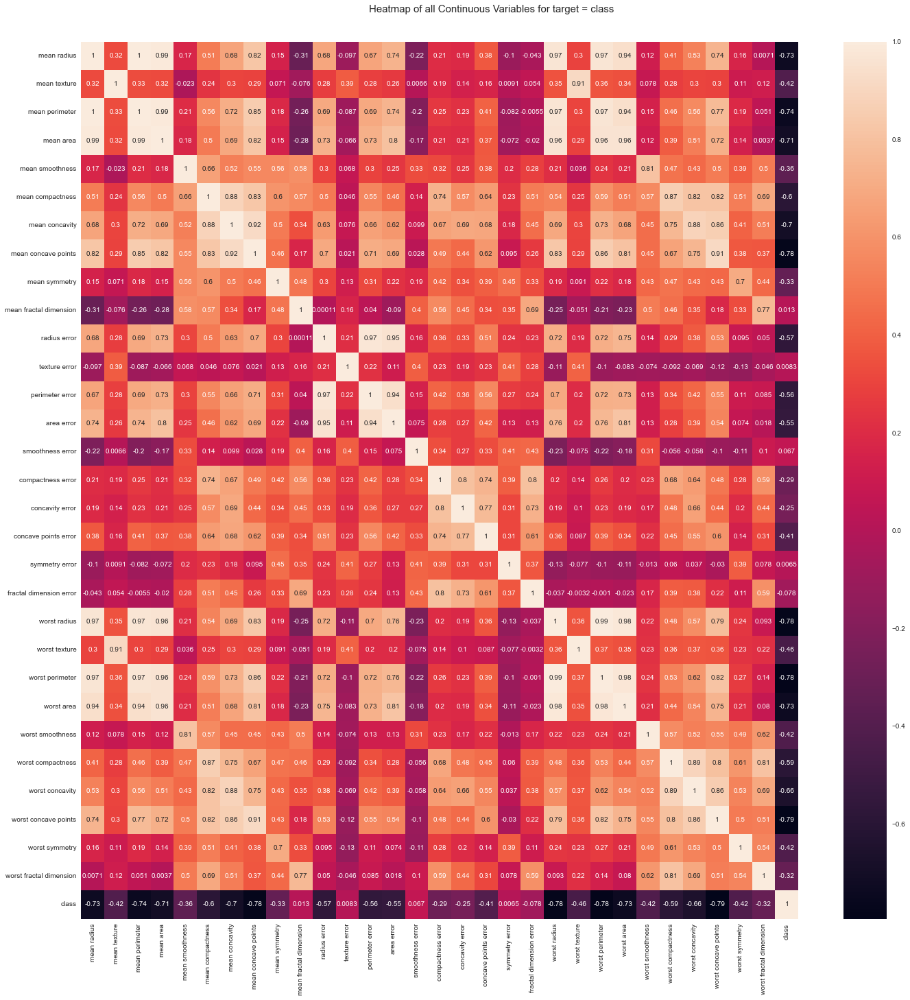

No categorical or boolean vars in data set. Hence no pivot plots...
No categorical or numeric vars in data set. Hence no bar charts.
Time to run AutoViz (in seconds) = 253

 ###################### VISUALIZATION Completed ########################


In [14]:
AV = AutoViz_Class()
dftc = AV.AutoViz(
    filename='', 
    sep='' , 
    depVar='class', 
    dfte=df, 
    header=0, 
    verbose=1, 
    lowess=False, 
    chart_format='png', 
    max_rows_analyzed=4000, 
    max_cols_analyzed=40
)

In [15]:
df.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'class'],
      dtype='object')

### Analysis of mean radius and mean texture

In [16]:
fig = px.histogram(
                    data_frame = df,
                    x = "mean radius",
                    color = "class", 
                    title = "<b>class vs mean radius</b>",
                    pattern_shape_sequence=['x'],
                    template = 'seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "mean texture",
                    color = "class", 
                    title = "<b>class vs mean texture</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [17]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("radius & mean texture",
                                    "mean radius",
                                    "mean texture",
                                    "mean radius vs mean texture"))

# Scatter Plot : Mean Radius vs Mean Texture
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['mean radius'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['mean texture'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['mean radius'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['mean texture'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : Mean Radius vs Mean Texture
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean radius'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['mean radius'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : Mean Radius vs Mean Texture
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean texture'],
                        showlegend=False,
                        name = 'Malignant',
                        marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(y =df[df['class']=='Benign']['mean texture'],
                        showlegend=False,
                        name = 'Benign',
                        marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : Mean Radius & Mean Texture
fig.add_trace(go.Bar(
                    x = tpc['tpc'],
                        name ='mean radius',
                    y = tpc['mean radius'],
                        showlegend=False,
                        text = round(df['mean radius'].mean(),2),
                        textposition = 'auto',
                        marker = dict(color='aquamarine', opacity=0.6)),
              row=2,col=2)
fig.add_trace(go.Bar(
                    x = tpc['tpc'],
                        name='mean texture',
                    y = tpc['mean texture'],
                        showlegend=False,
                        text = round(df['mean texture'].mean(),2),
                        textposition= 'auto',
                        marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="mean radius", row=1, col=1)
fig.update_yaxes(title_text="mean texture", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,30]), row=2, col=2)
fig.update_layout(
                title={
                    'text'     : "mean radius vs mean texture with hue as class",
                    'y'      :  1,
                    'x'      :  0.5,
                    'xanchor': 'center',
                    'yanchor': 'top'
                    },
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of mean perimeter and mean area

In [18]:
fig = px.histogram(
                    data_frame = df,
                    x = "mean perimeter",
                    color="class", 
                    title="<b>class vs mean perimeter</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "mean area",
                    color="class", 
                    title="<b>class vs mean area</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [19]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("perimeter & mean area",
                                    "mean perimeter",
                                    "mean area",
                                    "mean perimeter vs mean area"))

# Scatter Plot : Mean Perimeter vs Mean Area
fig.add_trace((go.Scatter(
                        x = df[df['class'] == 'Malignant']['mean perimeter'], 
                            showlegend=False, 
                            text='M',
                        y = df[df['class'] == 'Malignant']['mean texture'], 
                            name='Malignant', 
                            mode='markers',
                            marker = dict(color='darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x=df[df['class']=='Benign']['mean perimeter'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['mean area'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : Mean Perimeter vs Mean Area
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean perimeter'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['mean perimeter'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : Mean Perimeter vs Mean Area
fig.add_trace(go.Violin(
                    y = df[df['class']=='Malignant']['mean area'],
                        showlegend=False,
                        name = 'Malignant',
                        marker_color='crimson'),
              row=2,col=1)
fig.add_trace(go.Violin(
                    y = df[df['class']=='Benign']['mean area'],
                        showlegend=False,
                        name = 'B',
                        marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : Mean Perimeter & Mean Area
fig.add_trace(go.Bar(
                    x = tpc['tpc'], 
                        name='mean perimeter',
                    y = tpc['mean perimeter'],
                        showlegend=False,
                        text = round(df['mean perimeter'].mean(),2),
                        textposition= 'auto',
                        marker = dict(color = 'aquamarine',opacity=0.6)
                    ),
              row=2,col=2)
fig.add_trace(go.Bar(
                    x = tpc['tpc'], 
                        name='mean area',
                    y = tpc['mean area'],
                        showlegend=False,
                        text = round(df['mean area'].mean(),2),
                        textposition= 'auto',
                        marker = dict(color = 'fuchsia',opacity=0.6)
                    ),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="mean perimeter", row=1, col=1)
fig.update_yaxes(title_text="mean area", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,1000]), row=2, col=2)
fig.update_layout(
                    title={
                        'text'   : "mean perimeter vs mean area with hue as class",
                        'y'      :  1,
                        'x'      :  0.5,
                        'xanchor': 'center',
                        'yanchor': 'top'
                        },
                    height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of mean smoothness and mean compactness

In [20]:
fig = px.histogram(
                    data_frame = df,
                    x = "mean smoothness",
                    color = "class", 
                    title = "<b>class vs mean smoothness</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')
fig1 = px.histogram(
                    data_frame = df,
                    x = "mean compactness",
                    color = "class", 
                    title = "<b>class vs mean compactness</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [21]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("smoothness & mean compactness",
                                    "mean smoothness",
                                    "mean compactness",
                                    "mean smoothness vs mean compactness"))

# Scatter Plot : Mean Smoothness vs Mean Compactness
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['mean smoothness'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['mean compactness'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['mean smoothness'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['mean compactness'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : Mean Smoothness vs Mean Compactness
fig.add_trace(go.Violin(y =df[df['class']=='Malignant']['mean smoothness'],
                        showlegend=False,
                        name = 'Malignant',
                        marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(y =df[df['class']=='Benign']['mean smoothness'],
                        showlegend=False,
                        name = 'Benign',
                        marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : Mean Smoothness vs Mean Compactness
fig.add_trace(go.Violin(y =df[df['class']=='Malignant']['mean compactness'],
                        showlegend=False,
                        name = 'Malignant',
                        marker_color='crimson'),
              row=2,col=1)
fig.add_trace(go.Violin(y =df[df['class']=='Benign']['mean compactness'],
                        showlegend=False,
                        name = 'Benign',
                        marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : Mean Smoothness & Mean Compactness
fig.add_trace(go.Bar(
                    x = tpc['tpc'],
                        name = 'mean smoothness',
                    y = tpc['mean smoothness'],
                        showlegend=False,
                        text = round(df['mean smoothness'].mean(),2),
                        textposition = 'auto',
                        marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)
fig.add_trace(go.Bar(
                    x = tpc['tpc'],
                        name = 'mean compactness',
                    y = tpc['mean compactness'],
                        showlegend=False,
                        text = round(df['mean compactness'].mean(),2),
                        textposition = 'auto',
                        marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="mean smoothness", row=1, col=1)
fig.update_yaxes(title_text="mean compactness", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.2]), row=2, col=2)
fig.update_layout(
                    title={
                        'text'    : "mean smoothness vs mean compactness with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'
                        },
                    height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of mean concavity and mean concave points

In [22]:
fig = px.histogram(
                    data_frame = df,
                    x = "mean concavity",
                    color="class", 
                    title="<b>class vs mean concavity</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "mean concave points",
                    color="class", title="<b>class vs mean concave points</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [23]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("concavity & mean concave points",
                                    "mean concavity",
                                    "mean concave points",
                                    "mean concavity vs mean concave points"))

# Scatter Plot : mean concavity vs mean concave points
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['mean concavity'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['mean concave points'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['mean concavity'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['mean concave points'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise',
                            size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : mean concavity vs mean concave points
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean concavity'],
                            showlegend=False,
                            name = 'Malignnat',
                            marker_color='tomato'),
              row=1,col=2)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['mean concavity'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : mean concavity vs mean concave points
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean concave points'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['mean concave points'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : mean concavity vs mean concave points
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='mean concavity',
                        y = tpc['mean concavity'],
                            showlegend=False,
                            text = round(df['mean concavity'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='mean concave points',
                        y = tpc['mean concave points'],
                            showlegend=False,
                            text = round(df['mean concave points'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="mean concavity", row=1, col=1)
fig.update_yaxes(title_text="mean concave points", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.2]), row=2, col=2)
fig.update_layout(
                    title={
                        'text'    : "mean concavity vs mean concave points with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'
                        },
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of mean symmetry and mean fractal dimension

In [24]:
fig = px.histogram(
                    data_frame = df,
                    x = "mean symmetry",
                    color="class", 
                    title="<b>class vs mean symmetry</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "mean fractal dimension",
                    color="class", 
                    title="<b>class vs mean fractal dimension</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [25]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("symmetry & mean fractal dimension",
                                    "mean symmetry",
                                    "mean fractal dimension",
                                    "mean symmetry vs mean fractal dimension"))

# Scatter Plot : mean symmetry vs mean fractal dimension
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['mean symmetry'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['mean fractal dimension'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['mean symmetry'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['mean fractal dimension'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : mean symmetry vs mean fractal dimension
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean symmetry'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['mean symmetry'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : mean symmetry vs mean fractal dimension
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['mean fractal dimension'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['mean fractal dimension'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Box Plot : mean symmetry vs mean fractal dimension
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='mean symmetry',
                        y = tpc['mean symmetry'],
                            showlegend=False,
                            text = round(df['mean symmetry'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name = 'mean fractal dimension',
                        y = tpc['mean fractal dimension'],
                            showlegend=False,
                            text = round(df['mean fractal dimension'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="mean symmetry", row=1, col=1)
fig.update_yaxes(title_text="mean fractal dimension", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.2]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "mean symmetry vs mean fractal dimension with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of radius error and texture error

In [26]:
fig = px.histogram(
                    data_frame = df,
                    x = "radius error",
                    color = "class", 
                    title = "<b>class vs radius error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "texture error",
                    color = "class", 
                    title = "<b>class vs texture error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [27]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("radius error & texture error",
                                    "radius error",
                                    "texture error",
                                    "radius error vs texture error"))

# Scatter plot : radius error vs texture error
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['radius error'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['texture error'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['radius error'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['texture error'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin plot : radius error vs texture error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['radius error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['radius error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin plot : radius error vs texture error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['texture error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['texture error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar plot : radius error & texture error
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='radius error',
                        y = tpc['radius error'],
                            showlegend=False,
                            text = round(df['radius error'].mean(),2),
                            textposition = 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='texture error',
                        y = tpc['texture error'],
                            showlegend=False,
                            text = round(df['texture error'].mean(),2),
                            textposition = 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="radius error", row=1, col=1)
fig.update_yaxes(title_text="texture error", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,1.5]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "radius error vs texture error with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of perimeter error and area error

In [28]:
fig = px.histogram(
                    data_frame = df,
                    x = "perimeter error",
                    color = "class", 
                    title = "<b>class vs perimeter error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "area error",
                    color = "class", 
                    title = "<b>class vs area error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [29]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("perimeter error & area error",
                                    "perimeter error",
                                    "area error",
                                    "perimeter error vs area error"))

# Scatter Plot : perimeter error vs area error
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['perimeter error'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['area error'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange',
                            size=6,opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['perimeter error'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['area error'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise',
                            size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : perimeter error vs area error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['perimeter error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['perimeter error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : perimeter error vs area error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['area error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['area error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Box Plot : perimeter error vs area error
fig.add_trace(go.Bar(
                        x = tpc['tpc'],name='perimeter error',
                        y = tpc['perimeter error'],
                            showlegend=False,
                            text = round(df['perimeter error'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name ='area error',
                        y = tpc['area error'],
                            showlegend=False,
                            text = round(df['area error'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="perimeter error", row=1, col=1)
fig.update_yaxes(title_text="area error", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,80]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "perimeter error vs area error with hue as class",
                         'y'      :1,
                         'x'      :0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'
                    },
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of smoothness error vs compactness error

In [30]:
fig = px.histogram(
                    data_frame = df,
                    x = "smoothness error",
                    color = "class", 
                    title = "<b>class vs smoothness error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "compactness error",
                    color="class", 
                    title="<b>class vs compactness error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [31]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("smoothness error & compactness error",
                                    "smoothness error",
                                    "compactness error",
                                    "smoothness error vs compactness error"))

# Scatter plot : smoothness error & compactness error
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['smoothness error'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['compactness error'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5))),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['smoothness error'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['compactness error'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise',
                            size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin plot : smoothness error & compactness error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['smoothness error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['compactness error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin plot : smoothness error & compactness error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['compactness error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['compactness error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar plot : smoothness error & compactness error
fig.add_trace(go.Bar(x = tpc['tpc'],
                         name ='smoothness error',
                     y = tpc['smoothness error'],
                         showlegend=False,
                         text = round(df['smoothness error'].mean(),2),
                         textposition= 'auto',
                         marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(x = tpc['tpc'],
                     name='compactness error',
                     y = tpc['compactness error'],
                     showlegend=False,
                     text = round(df['compactness error'].mean(),2),
                     textposition= 'auto',
                     marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)


fig.update_xaxes(title_text="smoothness error", row=1, col=1)
fig.update_yaxes(title_text="compactness error", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.04]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "smoothness error vs compactness error with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of concavity error vs concave points error

In [32]:
fig = px.histogram(
                    data_frame = df,
                    x = "concavity error",
                    color = "class", 
                    title = "<b>class vs concavity error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "concave points error",
                    color = "class", 
                    title = "<b>class vs concave points error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [33]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("concavity error & concave points error",
                                    "concavity error",
                                    "concave points error",
                                    "concavity error vs concave points error"))

# Scatter Plot : concavity error vs concave points error
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['concavity error'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['concave points error'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['concavity error'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['concave points error'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : concavity error vs concave points error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['concavity error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['concavity error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : concavity error vs concave points error
fig.add_trace(go.Violin(
                        y =df[df['class']=="Malignant"]['concave points error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['concave points error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : concavity error vs concave points error
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='concavity error',
                        y = tpc['concavity error'],
                            showlegend=False,
                            text = round(df['concavity error'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='concave points error',
                        y = tpc['concave points error'],
                            showlegend=False,
                            text = round(df['concave points error'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)


fig.update_xaxes(title_text="concavity error", row=1, col=1)
fig.update_yaxes(title_text="concave points error", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.05]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "concavity error vs concave points error with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of symmetry error vs fractal dimension error

In [34]:
fig = px.histogram(
                    data_frame = df,
                    x = "symmetry error",
                    color = "class", 
                    title = "<b>class vs symmetry error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "fractal dimension error",
                    color = "class", 
                    title = "<b>class vs fractal dimension error</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [35]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("symmetry error & fractal dimension error",
                                    "symmetry error",
                                    "fractal dimension error",
                                    "symmetry error vs fractal dimension error"))

# Scatter Plot : symmetry error vs fractal dimension error
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['symmetry error'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['fractal dimension error'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange',
                            size=6,
                            opacity = 0.5))),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['symmetry error'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['fractal dimension error'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : symmetry error vs fractal dimension error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['symmetry error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['symmetry error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : symmetry error vs fractal dimension error
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['fractal dimension error'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['fractal dimension error'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : symmetry error vs fractal dimension error
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='symmetry error',
                        y = tpc['symmetry error'],
                            showlegend=False,
                            text = round(df['symmetry error'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='fractal dimension error',
                        y = tpc['fractal dimension error'],
                            showlegend=False,
                            text = round(df['fractal dimension error'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)


fig.update_xaxes(title_text="symmetry error", row=1, col=1)
fig.update_yaxes(title_text="fractal dimension error", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.1]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "symmetry error vs fractal dimension error with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'}, 
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of worst radius vs worst texture

In [36]:
fig = px.histogram(
                    data_frame = df,
                    x = "worst radius",
                    color = "class", 
                    title = "<b>class vs worst radius</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "worst texture",
                    color = "class", 
                    title = "<b>class vs worst texture</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [37]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("worst radius & worst texture",
                                    "worst radius",
                                    "worst texture",
                                    "worst radius vs worst texture"))

# Scatter plot : worst radius vs worst texture
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['worst radius'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['worst texture'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['worst radius'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['worst texture'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin plot : worst radius vs worst texture
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst radius'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst radius'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin plot : worst radius vs worst texture
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst texture'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst texture'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar plot : worst radius & worst texture
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='wors radius',
                        y = tpc['worst radius'],
                            showlegend=False,
                            text = round(df['worst radius'].mean(),2),
                            textposition = 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='worst texture',
                        y = tpc['worst texture'],
                            showlegend=False,
                            text = round(df['worst texture'].mean(),2),
                            textposition = 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="worst radius", row=1, col=1)
fig.update_yaxes(title_text="worst texture", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,40]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "worst radius vs worst texture= with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of worst perimeter vs worst area

In [38]:
fig = px.histogram(
                    data_frame = df,
                    x = "worst perimeter",
                    color = "class", 
                    title = "<b>class vs worst perimeter</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "worst area",
                    color = "class", 
                    title = "<b>class vs worst area</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [39]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("worst perimeter & worst area",
                                    "worst perimeter",
                                    "worst area",
                                    "worst perimeter vs worst area"))

# Scatter Plot : worst perimeter vs worst area
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['worst perimeter'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['worst area'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange',
                            size=6,opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['worst perimeter'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['worst area'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise',
                            size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : worst perimeter vs worst area
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst perimeter'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst perimeter'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : worst perimeter vs worst area
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst area'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst area'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Box Plot : worst perimeter vs worst area
fig.add_trace(go.Bar(
                        x = tpc['tpc'],name='worst perimeter',
                        y = tpc['worst perimeter'],
                            showlegend=False,
                            text = round(df['worst perimeter'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name ='worst area',
                        y = tpc['worst area'],
                            showlegend=False,
                            text = round(df['worst area'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)

# Plot labels
fig.update_xaxes(title_text="worst perimeter", row=1, col=1)
fig.update_yaxes(title_text="worst area", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,2000]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "worst perimeter vs worst area with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'
                    },
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of worst smoothness vs worst compactness

In [40]:
fig = px.histogram(
                    data_frame = df,
                    x = "worst smoothness",
                    color = "class", 
                    title = "<b>class vs worst smoothness</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "worst compactness",
                    color="class", 
                    title="<b>class vs worst compactness</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [41]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("worst smoothness & worst compactness",
                                    "worst smoothness",
                                    "worst compactness",
                                    "worst smoothness vs worst compactness"))

# Scatter plot : worst smoothness & worst compactness
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['worst smoothness'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['worst compactness'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5))),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['worst smoothness'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['worst compactness'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise',
                            size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin plot : worst smoothness & worst compactness
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst smoothness'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst compactness'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin plot : worst smoothness & worst compactness
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst compactness'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst compactness'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar plot : worst smoothness & worst compactness
fig.add_trace(go.Bar(x = tpc['tpc'],
                         name ='worst smoothness',
                     y = tpc['worst smoothness'],
                         showlegend=False,
                         text = round(df['worst smoothness'].mean(),2),
                         textposition= 'auto',
                         marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(x = tpc['tpc'],
                     name='worst compactness',
                     y = tpc['worst compactness'],
                     showlegend=False,
                     text = round(df['worst compactness'].mean(),2),
                     textposition= 'auto',
                     marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)


fig.update_xaxes(title_text="worst smoothness", row=1, col=1)
fig.update_yaxes(title_text="worst compactness", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.6]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "worst smoothness vs worst compactness with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of worst concavity vs worst concave points

In [42]:
fig = px.histogram(
                    data_frame = df,
                    x = "worst concavity",
                    color = "class", 
                    title = "<b>class vs worst concavity</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "worst concave points",
                    color = "class", 
                    title = "<b>class vs worst concave points</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [43]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("worst concavity & worst concave points",
                                    "worst concavity",
                                    "worst concave points",
                                    "worst concavity vs worst concave points"))

# Scatter Plot : worst concavity vs worst concave points
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['worst concavity'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['worst concave points'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange', size=6, opacity = 0.5)
                        )),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['worst concavity'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['worst concave points'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : worst concavity vs worst concave points
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst concavity'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst concavity'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : worst concavity vs worst concave points
fig.add_trace(go.Violin(
                        y =df[df['class']=="Malignant"]['worst concave points'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)

fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst concave points'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : worst concavity vs worst concave points
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='worst concavity',
                        y = tpc['worst concavity'],
                            showlegend=False,
                            text = round(df['worst concavity'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='worst concave points',
                        y = tpc['worst concave points'],
                            showlegend=False,
                            text = round(df['worst concave points'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)


fig.update_xaxes(title_text="worst concavity", row=1, col=1)
fig.update_yaxes(title_text="worst concave points", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.6]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "worst concavity vs worst concave points with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Analysis of worst symmetry vs worst fractal dimension

In [44]:
fig = px.histogram(
                    data_frame = df,
                    x = "worst symmetry",
                    color = "class", 
                    title = "<b>class vs worst symmetry</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig1 = px.histogram(
                    data_frame = df,
                    x = "worst fractal dimension",
                    color = "class", 
                    title = "<b>class vs worst fractal dimension</b>",
                    pattern_shape_sequence=['x'],
                    template='seaborn')

fig.update_layout(bargap=0.2)
fig1.update_layout(bargap = 0.2)

fig.show()
fig1.show()

In [45]:
tpc = pd.DataFrame(df.groupby(['class']).mean())
tpc['tpc'] = tpc.index
tpc = tpc.reset_index()
fig = make_subplots(rows=2,
                    cols=2,
                    subplot_titles=("worst symmetry & worst fractal dimension",
                                    "worst symmetry",
                                    "worst fractal dimension",
                                    "worst symmetry vs worst fractal dimension"))

# Scatter Plot : worst symmetry vs worst fractal dimension
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Malignant']['worst symmetry'],
                            showlegend=False,
                            text='M',
                        y = df[df['class']=='Malignant']['worst fractal dimension'],
                            name='Malignant',
                            mode='markers',
                            marker = dict(color= 'darkorange',
                            size=6,
                            opacity = 0.5))),
              row=1,col=1)
fig.add_trace((go.Scatter(
                        x = df[df['class']=='Benign']['worst symmetry'],
                            showlegend=False,
                            text='B',
                        y = df[df['class']=='Benign']['worst fractal dimension'],
                            name='Benign',
                            mode='markers',
                            marker = dict(color= 'darkturquoise', size=6, opacity = 0.5)
                        )),
              row=1,col=1)

# Violin Plot : worst symmetry vs worst fractal dimension
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst symmetry'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='tomato'),
              row=1,col=2)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst symmetry'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='forestgreen'),
              row=1,col=2)

# Violin Plot : worst symmetry vs worst fractal dimension
fig.add_trace(go.Violin(
                        y = df[df['class']=='Malignant']['worst fractal dimension'],
                            showlegend=False,
                            name = 'Malignant',
                            marker_color='crimson'),
              row=2,col=1)
fig.add_trace(go.Violin(
                        y = df[df['class']=='Benign']['worst fractal dimension'],
                            showlegend=False,
                            name = 'Benign',
                            marker_color='mediumpurple'),
              row=2,col=1)

# Bar Plot : worst symmetry vs worst fractal dimension
fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='worst symmetry',
                        y = tpc['worst symmetry'],
                            showlegend=False,
                            text = round(df['worst symmetry'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'aquamarine', opacity=0.6)),
              row=2,col=2)

fig.add_trace(go.Bar(
                        x = tpc['tpc'],
                            name='worst fractal dimension',
                        y = tpc['worst fractal dimension'],
                            showlegend=False,
                            text = round(df['worst fractal dimension'].mean(),2),
                            textposition= 'auto',
                            marker = dict(color = 'fuchsia', opacity=0.6)),
              row=2,col=2)


fig.update_xaxes(title_text="worst symmetry", row=1, col=1)
fig.update_yaxes(title_text="worst fractal dimension", row=1, col=1)
fig.update_yaxes(title_text="Frequency", row=1, col=2)
fig.update_xaxes(title_text="class", row=2, col=1)
fig.update_xaxes(title_text="class", row=2, col=2)
fig.update_yaxes(range = ([0,0.5]), row=2, col=2)
fig.update_layout(
                title={
                        'text'    : "worst symmetry vs worst fractal dimensio with hue as class",
                         'y'      :  1,
                         'x'      :  0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'}, 
                height = 1000, width = 1000, template='seaborn')

iplot(fig)

### Group Analysis of both tumors

In [46]:
df1 = df.groupby('class').agg({'mean radius' : 'mean', 'mean texture' : 'mean', 'mean perimeter' : 'mean',
       'mean area' : 'mean', 'mean smoothness' : 'mean', 'mean compactness' : 'mean', 'mean concavity' :'mean',
       'mean concave points' : 'mean', 'mean symmetry' : 'mean', 'mean fractal dimension' : 'mean',
       'radius error' : 'mean', 'texture error' : 'mean', 'perimeter error' : 'mean', 'area error' : 'mean', 'smoothness error' : 'mean',
       'compactness error' : 'mean', 'concavity error' : 'mean', 'concave points error' : 'mean', 'symmetry error' : 'mean',
       'fractal dimension error' : 'mean', 'worst radius' : 'mean', 'worst texture' : 'mean',
       'worst perimeter' : 'mean', 'worst area' : 'mean', 'worst smoothness' : 'mean',
       'worst compactness' : 'mean', 'worst concavity' : 'mean', 'worst concave points' : 'mean',
       'worst symmetry' : 'mean', 'worst fractal dimension': 'mean'})
df1

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
class,,,,,,,,,,,,,,,,,,,,,
Benign,12.146524,17.914762,78.075406,462.790196,0.092478,0.080085,0.046058,0.025717,0.174186,0.062867,...,13.379801,23.515070,87.005938,558.899440,0.124959,0.182673,0.166238,0.074444,0.270246,0.079442
Malignant,17.462830,21.604906,115.365377,978.376415,0.102898,0.145188,0.160775,0.087990,0.192909,0.062680,...,21.134811,29.318208,141.370330,1422.286321,0.144845,0.374824,0.450606,0.182237,0.323468,0.091530


In [47]:
px.bar(data_frame=df1.drop(['worst radius','worst texture',
       'worst perimeter' , 'worst area','area error','mean perimeter','mean area','mean texture','mean radius'],axis = 1), 
       barmode='group',
       title = "<b>Class wise Analysis</b>",
       template="seaborn")

In [48]:
px.bar(data_frame=df1[['worst radius','worst texture',
       'worst perimeter' , 'worst area','area error','mean perimeter','mean area','mean texture','mean radius']], 
       barmode='group',
       title = "<b>Class wise Analysis</b>",
       template="seaborn")

### Case where Benign mean > Malignant Mean

In [49]:
df1.loc['Benign'] > df1.loc['Malignant']

mean radius                False
mean texture               False
mean perimeter             False
mean area                  False
mean smoothness            False
mean compactness           False
mean concavity             False
mean concave points        False
mean symmetry              False
mean fractal dimension      True
radius error               False
texture error               True
perimeter error            False
area error                 False
smoothness error            True
compactness error          False
concavity error            False
concave points error       False
symmetry error              True
fractal dimension error    False
worst radius               False
worst texture              False
worst perimeter            False
worst area                 False
worst smoothness           False
worst compactness          False
worst concavity            False
worst concave points       False
worst symmetry             False
worst fractal dimension    False
dtype: boo

Only in the cases of:
- mean fractal dimension
- texture error
- smoothness error  
- symmetry error  

In [50]:
px.bar(data_frame=df1[['mean fractal dimension','texture error','smoothness error','symmetry error']], 
       barmode='group',
       title = "<b>Class wise Analysis where Benign > Malignant</b>",
       template="seaborn")

### Box-plot of Benign

In [51]:
list1 = ['mean smoothness', 'mean compactness', 'mean concavity', 'mean concave points', 'mean symmetry', 'compactness error', 'concavity error', 'worst concave points', 'worst symmetry', 'worst smoothness',  'worst fractal dimension']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list1)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list1[i]],
                         showlegend=False ,
                         name = list1[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Benign' + str(list1),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 2000,
                  height=450,
                  template='plotly')
iplot(fig)

In [52]:
list2 = ['mean fractal dimension', 'smoothness error', 'concave points error', 'symmetry error', 'fractal dimension error']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list2)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list2[i]],
                         showlegend=False ,
                         name = list2[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Benign' + str(list2),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [53]:
list3 = ['radius error', 'worst compactness', 'worst concavity']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list3)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list3[i]],
                         showlegend=False ,
                         name = list3[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Benign' + str(list3),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [54]:
list4 = ['texture error', 'perimeter error']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list4)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list4[i]],
                         showlegend=False ,
                         name = list4[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Benign' + str(list4),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [55]:
list5 = ['mean radius', 'mean texture', 'area error', 'worst radius', 'worst texture']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list5)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list5[i]],
                         showlegend=False ,
                         name = list5[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Benign' + str(list5),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [57]:
list6 = ['mean perimeter', 'worst perimeter']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list6)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list6[i]],
                         showlegend=False ,
                         name = list6[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Benign' + str(list6),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [58]:
list7 = ['mean area', 'worst area']
fig = make_subplots(rows=2,cols=1,shared_yaxes=True,subplot_titles=("Benign"))
for i in range(len(list7)):
    fig.add_trace(go.Box(y =df[df['class']=='Benign'][list7[i]],
                         showlegend=False ,
                         name = list7[i],
                         marker_color='darkviolet'),
                  row=1,col=1)
    
fig.update_layout(title={'text': 'Benign' + str(list7),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

### Box Plot for Malignant

In [59]:
list1 = ['mean smoothness', 'mean compactness', 'mean concavity', 'mean concave points', 'mean symmetry', 'compactness error', 'concavity error', 'worst concave points', 'worst symmetry', 'worst smoothness',  'worst fractal dimension']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list1)):
    fig.add_trace(go.Box(y =df[df['class']=="Malignant"][list1[i]],
                         showlegend=False ,
                         name = list1[i],
                         marker_color='firebrick'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Malignant' + str(list1),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 2000,
                  height=450,
                  template='plotly')
iplot(fig)

In [60]:
list2 = ['mean fractal dimension', 'smoothness error', 'concave points error', 'symmetry error', 'fractal dimension error']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list2)):
    fig.add_trace(go.Box(y =df[df['class']=='Malignant'][list2[i]],
                         showlegend=False ,
                         name = list2[i],
                         marker_color='firebrick'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Malignant' + str(list2),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [61]:
list3 = ['radius error', 'worst compactness', 'worst concavity']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list3)):
    fig.add_trace(go.Box(y =df[df['class']=='Malignant'][list3[i]],
                         showlegend=False ,
                         name = list3[i],
                         marker_color='firebrick'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Malignant' + str(list3),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [62]:
list4 = ['texture error', 'perimeter error']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list4)):
    fig.add_trace(go.Box(y =df[df['class']=='Malignant'][list4[i]],
                         showlegend=False ,
                         name = list4[i],
                         marker_color='firebrick'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Malignant' + str(list4),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [63]:
list5 = ['mean radius', 'mean texture', 'area error', 'worst radius', 'worst texture']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list5)):
    fig.add_trace(go.Box(y =df[df['class']=='Malignant'][list5[i]],
                         showlegend=False ,
                         name = list5[i],
                         marker_color='firebrick'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Malignant' + str(list5),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [64]:
list6 = ['mean perimeter', 'worst perimeter']
fig = make_subplots(rows=1,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list6)):
    fig.add_trace(go.Box(y =df[df['class']=='Malignant'][list6[i]],
                         showlegend=False ,
                         name = list6[i],
                         marker_color='firebrick'),
                  row=1,col=1)
fig.update_layout(title={'text': 'Malignant' + str(list6),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)

In [65]:
list7 = ['mean area', 'worst area']
fig = make_subplots(rows=2,cols=1,shared_yaxes=True,subplot_titles=("Malignant"))
for i in range(len(list7)):
    fig.add_trace(go.Box(y =df[df['class']=='Malignant'][list7[i]],
                         showlegend=False ,
                         name = list7[i],
                         marker_color='firebrick'),
                  row=1,col=1)
    
fig.update_layout(title={'text': 'Malignant' + str(list7),
                         'y':0.9,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'},
                  width = 1000,
                  height=450,
                  template='plotly')
iplot(fig)